# An Exploration of Planetary SPH Simulation

## Imported Packages

In [50]:
import math
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib.animation as animation
mpl.rcParams['animation.ffmpeg_path'] = r'C:\ffmpeg\bin\ffmpeg.exe'

import scipy
from scipy import interpolate
from scipy.interpolate import CubicSpline
from scipy.integrate import solve_ivp, odeint

import numba
from numba import jit, njit, prange, vectorize

from tqdm.notebook import tqdm

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import re

## Constants and Units

In [2]:
#Physical Constants
Rjup_mks = 71490000.0 #Radius of Jupiter
Rearth_mks = 6378000.0 # radius of Erth
Rmars_mks = 3389500.0  # radius of Mars
Rmoon_mks = 1737400.0  # radius of the moon

Msun_mks=1.98911e30 #mass of Sun kg
Mjup_mks = 1.898e27 #mass of Jupiter kg
Mearth_mks=5.97219e24 #Mass of the Earth kg
Mmars_mks = 6.4169e23 # mass of Mars
Mmoon_mks = 7.346e22  # mass of the moon

Yr_mks=31557600.0e0 #length of year in sec
minute_mks = 60 # a minute in s
hour_mks = 3600 #an hour in s
Gr_mks=6.67408e-11 #Graviational constant

pi32=np.pi**(3/2) #Pi^3/2

In [3]:
# Base Units
MU=Mearth_mks
MUNAME = " Earth Masses"
MUNAME_LATEX = "$M_\oplus$"

LU=Rearth_mks
LUNAME = " Earth Radii"
LUNAME_LATEX = "$R_\oplus$" 

"""
TU=hour_mks
TUNAME = " hour"
TUNAME_LATEX = "hour"
"""

Kgas_mks=2.6e5 #gas constant [N m^4 / kg^2]  # temp
gamma=2    #gas index (unitless)
TU=np.sqrt(LU**5/(MU*Kgas_mks))
TUNAME = "Time units"

print("Mass unit:", MU, "kg")
print("Length unit:", LU, "m")
print("Time unit:", TU, "s")

Mass unit: 5.97219e+24 kg
Length unit: 6378000.0 m
Time unit: 82.44376283515696 s


In [4]:
# Derived units
DENSNAME = " Density Units"
DENSNAME_LATEX = "$M_\oplus$ / $R_\oplus^{~~3}$"
DENSU = MU/LU**3
MOD_DENSU = DENSU/1000
MOD_DENSNAME = "g/cm^3"
MOD_DENSNAME_LATEX = "g/cm$^3$"
print("Density unit:", DENSU, "kg/cm^3 =", MOD_DENSU, MOD_DENSNAME)

PRESNAME = " Pressure Units"
PRESNAME_LATEX = PRESNAME
PRESU = MU/(LU*TU*TU)
MOD_PRESU = PRESU/1e9
MOD_PRESNAME = "GPa"
MOD_PRESNAME_LATEX = MOD_PRESNAME
print("Pressure unit:", PRESU, "Pa =", MOD_PRESU, MOD_PRESNAME)

Density unit: 23018.66175354319 kg/cm^3 = 23.018661753543192 g/cm^3
Pressure unit: 137763285120248.34 Pa = 137763.28512024836 GPa


In [5]:
# Converting physical constant to new units
Rjup = Rjup_mks/LU
Rearth = Rearth_mks/LU
Rmars = Rmars_mks/LU
Rmoon = Rmoon_mks/LU

Msun = Msun_mks/MU
Mjup = Mjup_mks/MU
Mearth = Mearth_mks/MU
Mmars = Mmars_mks/MU
Mmoon = Mmoon_mks/MU

minute = minute_mks/TU
hour = hour_mks/TU

Yr=Yr_mks/TU
Gr=Gr_mks*TU*TU*MU/LU**3

In [6]:
print("G = ", Gr, "sim units")
print("Typical Bulk Modulus:", 156e9/PRESU, "sim units")
print("Typical Density:", 8.30e3/DENSU, "sim units")

G =  0.010442081774104614 sim units
Typical Bulk Modulus: 0.0011323771777352254 sim units
Typical Density: 0.3605770000387797 sim units


#### Free fall time
https://en.wikipedia.org/wiki/Free-fall_time

In [7]:
print((np.pi/np.sqrt(Gr*Mearth)*(Rearth/2.)**(1.5)), TUNAME, sep=' ')

10.869544233220328 Time units


Therefore, we are expecting that it takes higher than the order of 10 units of time for a particle to fall in to the planet. Of course, this is only a lower bound, there is extra time required for particles to sink to the center of the planet due to pressure and visocity.

## Integrator

In [8]:
## LEAP FROG INTEGRATOR

def leapfrog(y0, dt, t_span, mass, N, h, nu=0.2, nobackintegration=True):
    """
    Integrates using the leap frog technique.
    
    State is defined in the form [[x_i, x_{i+2}, ...], [v_{i-1}, v_{i+1}, ...]]. 
    So the velocity always lags behind by dt. The ... are for more particles.
    
    nobackintegration = True ignores the initial back integration of velocity
    """
    
    t0, tf = t_span
    num_t = int((tf - t0)/dt)+1
    ts = [t0 + nt*dt for nt in range(num_t)]  # quickly grab all the ts needed
    
    oneminnu = 1-nu # viscosity term
    dt2 = 2*dt
    
    last_x = y0[0].copy()
    if not nobackintegration:
        last_v = y0[1].copy()*oneminnu - (dt/2.)*calcdxdt(last_x,mass,N,h)  # integrate backwards a halfstep in velocity using euler method
    else:
        last_v = y0[1].copy()
    
    states = np.zeros((num_t, 2, N*3))  # 2 for position, velocity, and 3N for 3D 
    states[0] = [last_x.copy(), last_v.copy()]
    enumerated_ts = [(i+1, t) for i, t in enumerate(ts[1:])]
    
    pbar = tqdm(total=len(ts))
    pbar.update(1)
    
    for i, t in enumerated_ts:
        last_v = last_v*oneminnu + dt2*calcdxdt(last_x,mass,N,h) # v_{i-1} --> v_{i+1}
        last_x += dt2*last_v                                      # x_{i} --> x_{i+2}
        states[i] = [last_x, last_v]
        pbar.update(1)
    
    pbar.close()
    return ts, states

## Equation of State

In [9]:
## Constants for the EOSs

Kgas_mks=2.6e5 #gas constant [N m^4 / kg^2]
gamma=2    #gas index (unitless)
Kgas = Kgas_mks*MU*TU*TU/(LU**5)

# The following values are taken from Table 1 of Seager et al., 2007 (https://arxiv.org/pdf/0707.2895.pdf)

## epsilon iron ##
K0_epsFe_mks = 156e9  # bulk modulus [Pa = kg/(m s^2)]
dK0dP_epsFe = 6.08  # derivative of bulk modulus with respect to pressure [unitless]
rho0_epsFe_mks = 8.30e3 # rho0 [kg/m^3]

K0_epsFe = K0_epsFe_mks/PRESU
rho0_epsFe = rho0_epsFe_mks/DENSU

## perovskite MgSiO3 (a silicate) ##
K0_pvMgSiO3_mks = 247e9  # bulk modulus [Pa = kg/(m s^2)]
dK0dP_pvMgSiO3 = 3.97  # derivative of bulk modulus with respect to pressure [unitless]
rho0_pvMgSiO3_mks = 4.10e3 # rho0 [kg/m^3]

K0_pvMgSiO3 = K0_pvMgSiO3_mks/PRESU
rho0_pvMgSiO3 = rho0_pvMgSiO3_mks/DENSU


The Murnaghan equation of state (not to be confused with the Birch-Murnaghan EOS) is given by

$$ P(\rho) = \frac{K_0}{K_0'}\left[ \eta^{K_0'} -1 \right]$$

where $K_0 \equiv - V(\frac{\partial P}{\partial V})_T$ is the material bulk modulus, $K_0' \equiv \frac{dK_0}{dP}$ is its derivative with respect to the pressure $P$, and $\eta = \frac{\rho}{\rho_0}$ is the compression ratio with respect to the ambient density $\rho_0$.

The third-order Birch-Murnaghan equation (BME) is

$$ P(\rho) = \frac{3}{2}K_0\left( \eta^\frac{7}{3} - \eta^\frac{5}{3} \right)\left[1+\frac{3}{4}(K_0' - 4) \left( \eta^\frac{2}{3} -1 \right)\right] $$

The Vinet equation is 

$$ P(\rho) = 3K_0\eta^\frac{2}{3}\left(1 - \eta^{-\frac{1}{3}} \right)\exp\left[\frac{3}{2}(K_0' -1)(1-\eta^{-\frac{1}{3}})\right] $$

In [10]:
@jit(nopython=True)
def idealgas_EOS(rho, Kgas, gamma):
    """Ideal gas equation of state"""
    return Kgas*rho**gamma

@jit(nopython=True)
def murnaghan_EOS(rho, K0, dK0dP, rho0):
    """Murnaghan equation of state"""
    return (K0/dK0dP)*((rho/rho0)**dK0dP - 1)

@jit(nopython=True)
def BME3rdorder_EOS(rho, K0, dK0dP, rho0):
    """Third-order Birch-Murnaghan equation (BME)"""
    cbrteta = (rho/rho0)**(1/3)
    return 1.5*K0*(cbrteta**7 - cbrteta**5)*(1+0.75*(dK0dP-4)*(cbrteta*cbrteta-1))

@jit(nopython=True)
def vinet_EOS(rho, K0, dK0dP, rho0):
    """Vinet equation"""
    cbrteta = (rho/rho0)**(1/3)
    return 3*K0*(cbrteta**2 - cbrteta)*np.exp(1.5*(dK0dP-1)*(1 - 1/cbrteta))

In [11]:
# Test to see if using gpu will be faster for our use case
import math
@vectorize(['float32(float32, float32, float32, float32)'], target='cuda')
def vinet_EOS_gpu(rho, K0, dK0dP, rho0):
    """Vinet equation"""
    cbrteta = (rho/rho0)**(1/3)
    return 3*K0*(cbrteta**2 - cbrteta)*math.exp(1.5*(dK0dP-1)*(1 - 1/cbrteta))

print("N = 10,000:")
_l = np.array(list(range(10000))).astype(np.float32)
%timeit vinet_EOS(_l, K0_epsFe, dK0dP_epsFe, rho0_epsFe)   # cpu
%timeit vinet_EOS_gpu(_l, K0_epsFe, dK0dP_epsFe, rho0_epsFe)  # gpu

print("\nN = 1,000,000:")
_l = np.array(list(range(1000000))).astype(np.float32)
%timeit vinet_EOS(_l, K0_epsFe, dK0dP_epsFe, rho0_epsFe)   # cpu
%timeit vinet_EOS_gpu(_l, K0_epsFe, dK0dP_epsFe, rho0_epsFe)  # gpu

del _l
# Conclusion: Not worth it for the amount of particles we are running. 
#            Maybe if I vectorized the N^2 loop it could be a bit better, 
#            but this will likely take more time than it is worth

N = 10,000:
187 µs ± 19.2 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


C:\Users\Jaeden\mambaforge\lib\site-packages\numba\cuda\dispatcher.py:488: NumbaPerformanceWarning: Grid size 14 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))


1.02 ms ± 63.2 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)

N = 1,000,000:
20.8 ms ± 209 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)
4.69 ms ± 111 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


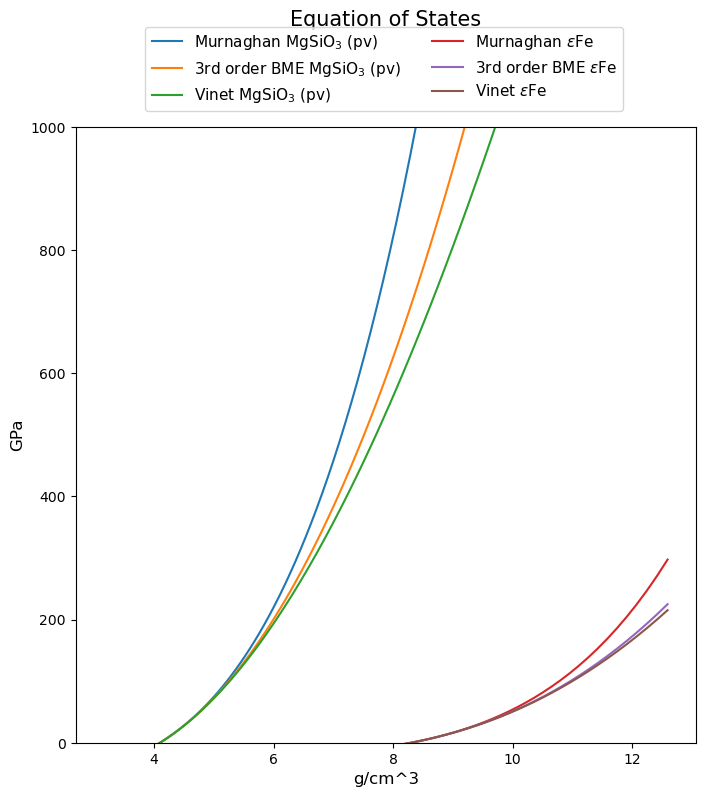

In [12]:
_rhos = np.logspace(3.5, 4.1, num=100)/DENSU

_pressures = {
    "Murnaghan MgSiO$_3$ (pv)": murnaghan_EOS(_rhos, K0_pvMgSiO3, dK0dP_pvMgSiO3, rho0_pvMgSiO3),
    "3rd order BME MgSiO$_3$ (pv)": BME3rdorder_EOS(_rhos, K0_pvMgSiO3, dK0dP_pvMgSiO3, rho0_pvMgSiO3),
    "Vinet MgSiO$_3$ (pv)": vinet_EOS(_rhos, K0_pvMgSiO3, dK0dP_pvMgSiO3, rho0_pvMgSiO3),
    "Murnaghan $\epsilon$Fe": murnaghan_EOS(_rhos, K0_epsFe, dK0dP_epsFe, rho0_epsFe),
    "3rd order BME $\epsilon$Fe": BME3rdorder_EOS(_rhos, K0_epsFe, dK0dP_epsFe, rho0_epsFe),
    "Vinet $\epsilon$Fe": vinet_EOS(_rhos, K0_epsFe, dK0dP_epsFe, rho0_epsFe),
    #"Ideal Gas": idealgas_EOS(_rhos, Kgas, gamma)
}

plt.figure(figsize=(8, 8))
plt.title("Equation of States\n\n\n\n", fontsize=15)
_legend = []
for n, p in _pressures.items():
    _legend.append(n)
    plt.plot(_rhos*MOD_DENSU, p*MOD_PRESU)
    
plt.legend(_legend, fontsize=11, ncol=2, bbox_to_anchor=(0.1, 1.175), loc="upper left")
plt.ylabel("GPa", fontsize=12)
plt.xlabel("g/cm^3", fontsize=12)
plt.ylim([0, 1000])
#plt.yscale('log')
#plt.xscale('log')
plt.show()

In [13]:
## choose the particle types used

# particle1 = epsilon iron
K0_parttype1 = K0_epsFe
dK0dP_parttype1 = dK0dP_epsFe
rho0_parttype1 = rho0_epsFe

# particle2 = perovskite MgSiO3
K0_parttype2 = K0_pvMgSiO3
dK0dP_parttype2 = dK0dP_pvMgSiO3
rho0_parttype2 = rho0_pvMgSiO3

# abundance of particle types (ratio in number of particular particles to total number of particles) 
parttype1_abund = 1 #0.3
parttype2_abund = 1 - parttype1_abund

print("Particle 1: {}% by number".format(parttype1_abund*100))
print("Bulk Modulus: {} {}".format(K0_parttype1*MOD_PRESU, MOD_PRESNAME), "Minimum Density: {} {}".format(rho0_parttype1*MOD_DENSU, MOD_DENSNAME), sep="\n")
print("\nParticle 2: {}% by number".format(parttype2_abund*100))
print("Bulk Modulus: {} {}".format(K0_parttype2*MOD_PRESU, MOD_PRESNAME), "Minimum Density: {} {}".format(rho0_parttype2*MOD_DENSU, MOD_DENSNAME), sep="\n")

Particle 1: 100% by number
Bulk Modulus: 156.0 GPa
Minimum Density: 8.3 g/cm^3

Particle 2: 0% by number
Bulk Modulus: 247.00000000000003 GPa
Minimum Density: 4.1 g/cm^3


In [14]:
# choose the equations of states used

part1_equation_of_state = vinet_EOS
part2_equation_of_state = vinet_EOS

@jit(nopython=True)
def two_particle_equation_of_state(rho, N):
    k = int(parttype1_abund*N)
    p = np.concatenate((
        part1_equation_of_state(rho[:k], K0_parttype1, dK0dP_parttype1, rho0_parttype1), 
        part2_equation_of_state(rho[k:], K0_parttype2, dK0dP_parttype2, rho0_parttype2)
    ))
    p[p<0]=0
    return p

In [15]:
# test multiparticle EOS
_rho = np.array([0.5, 0.7, 1, 0, 0, 0, 0, 0.5, 0.7, 1])
_N = len(_rho)
_k = int(parttype1_abund*_N)

_ps = two_particle_equation_of_state(_rho, _N)
print("Particle 1:  rho =", _rho[:3], " =>  P =", _ps[:3])
print("Particle 2:  rho =", _rho[-3:], " =>  P =", _ps[-3:])

Particle 1:  rho = [0.5 0.7 1. ]  =>  P = [0.00095778 0.00475554 0.01738153]
Particle 2:  rho = [0.5 0.7 1. ]  =>  P = [0.00095778 0.00475554 0.01738153]


In [16]:
## choose the equation of state function

equation_of_state = two_particle_equation_of_state


## Smoothing Kernel function

The normalized Gaussian kernel is given by

$$W(R,h) = \frac{1}{\pi^\frac{3}{2}h^3}\exp\left[-\left(\frac{R}{h}\right)^2\right]$$

where $R \equiv |\vec{r}|$ is the norm of the difference in position between the two particles, and $h$ is the smoothing length.

The cubic spline kernel is given by 

$$W(R,h) = \frac{1}{4\pi h^3}\begin{cases} 
      4 - 3q^2(2 - q) &  0 \leq q < 1 \\
      (2 - q)^3 & 1 \leq q < 2 \\
      0 & q \geq 2
   \end{cases}$$
   
where $q\equiv \frac{R}{h}$. The kernel is normalized by integrating over the spherical volume. Namely,

$$ \int \int_0^\infty r^2 W(r,h) dr d\Omega  = 1$$

where $\Omega$ is the solid angle. Since the kernel function is independent of $\Omega$, the normalization condition becomes

$$\int_0^\infty r^2 W(r,h) dr = 4\pi^2$$

In [17]:
# smoothing kernels implementation
@jit(nopython=True)
def gaussian_kernel(R, h, norm):
    return np.exp(-(R/h)**2)*norm
    
@jit(nopython=True)
def cubic_spline_kernel(R, h, norm):
    q = R/h
    if 0 <= q < 1:
        return (4 - 3*q*q*(2 - q))*norm
    if q < 2:
        return ((2 - q)**3)*norm
    return 0

@jit(nopython=True)
def precalculate_gaussian_norm(h):
    return 1/(h**3*np.pi**(3/2))

@jit(nopython=True)
def precalculate_cubic_spline_norm(h):
    return 1/(h**3*np.pi*4)

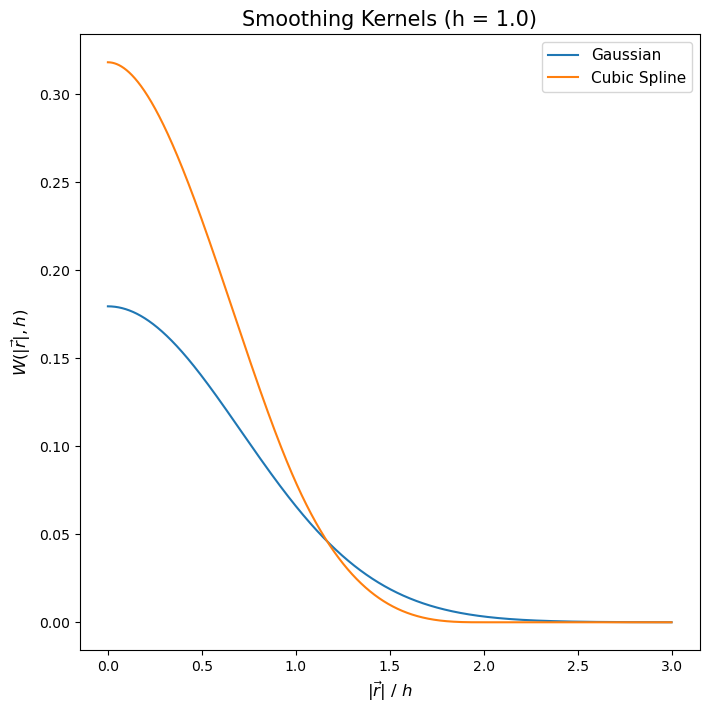

In [18]:
# plot of smoothing kernels
_rs = np.linspace(0, 3, num=10000)
_h = 1.0

_gaussian_norm = precalculate_gaussian_norm(_h)
_cubic_spline_norm = precalculate_cubic_spline_norm(_h)

_kernel_functions = {
    "Gaussian": [gaussian_kernel(r, _h, _gaussian_norm) for r in _rs],
    "Cubic Spline": [cubic_spline_kernel(r, _h, _cubic_spline_norm) for r in _rs],
}

plt.figure(figsize=(8, 8))
plt.title("Smoothing Kernels (h = {})".format(_h), fontsize=15)
_legend = []
for n, ws in _kernel_functions.items():
    _legend.append(n)
    plt.plot(_rs, ws)
    
plt.legend(_legend, fontsize=11, loc="upper right")
plt.ylabel(r"$W(|\vec{r}|,h)$", fontsize=12)
plt.xlabel(r"$|\vec{r}|$ / $h$", fontsize=12)
plt.show()

del _rs

In [19]:
# the derivatives of the smoothing kernels
@jit(nopython=True)
def dW_gaussian_kernel(R, h, dWnorm, RVec):
    return np.exp(-(R/h)**2)*dWnorm*RVec
    
@jit(nopython=True)
def dW_cubic_spline_kernel(R, h, dWnorm, RVec):
    q = R/h
    if 0 <= q < 1:
        return dWnorm*(4-3*q)*RVec
    if q < 2:
        return dWnorm*(4.0/q + q - 4)*RVec
    return 0.0*RVec

@jit(nopython=True)
def precalculate_gaussian_dWnorm(h):
    return -2.0/(h**5*np.pi**(3/2))

@jit(nopython=True)
def precalculate_cubic_spline_dWnorm(h):
    return -3.0/(h**5*np.pi*4)


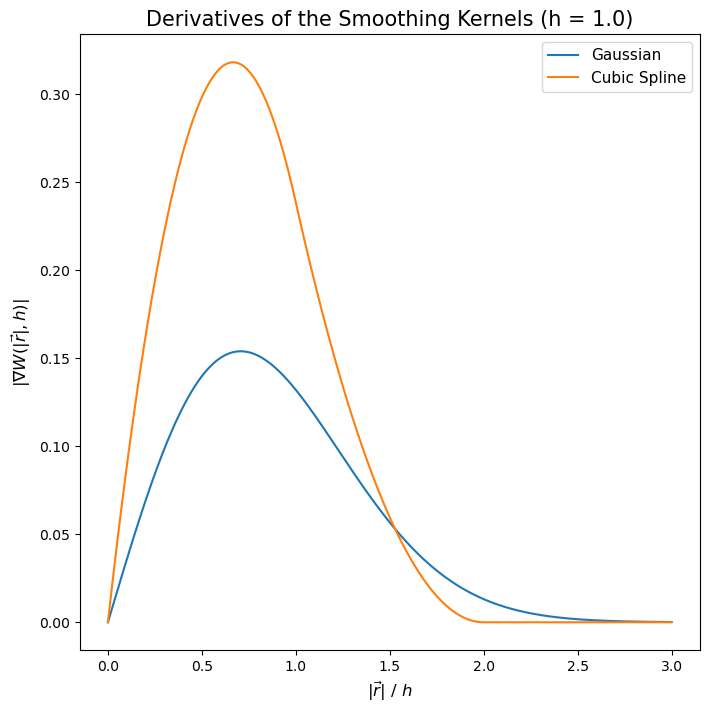

In [20]:
# make a plot of the derivatives of the smoothing kernels
_rs = np.linspace(0, 3, num=10000)
_h = 1.0

_gaussian_dWnorm = precalculate_gaussian_dWnorm(_h)
_cubic_spline_dWnorm = precalculate_cubic_spline_dWnorm(_h)

_kernel_functions = {
    "Gaussian": [abs(dW_gaussian_kernel(r, _h, _gaussian_dWnorm, np.array([r, 0, 0]))[0]) for r in _rs],
    "Cubic Spline": [abs(dW_cubic_spline_kernel(r, _h, _cubic_spline_dWnorm, np.array([r, 0, 0]))[0]) for r in _rs],
}

plt.figure(figsize=(8, 8))
plt.title("Derivatives of the Smoothing Kernels (h = {})".format(_h), fontsize=15)
_legend = []
for n, ws in _kernel_functions.items():
    _legend.append(n)
    plt.plot(_rs, ws)
    
plt.legend(_legend, fontsize=11, loc="upper right")
plt.ylabel(r"$|\nabla W(|\vec{r}|,h)|$", fontsize=12)
plt.xlabel(r"$|\vec{r}|$ / $h$", fontsize=12)
plt.show()

del _rs

In [21]:
# Assembling this together

gaussian_kernel_functions = (gaussian_kernel, dW_gaussian_kernel, precalculate_gaussian_norm, precalculate_gaussian_dWnorm, "Gaussian")
cubic_spline_functions = (cubic_spline_kernel, dW_cubic_spline_kernel, precalculate_cubic_spline_norm, precalculate_cubic_spline_dWnorm, "Cubic Spline")


# pick the kernel you want:

kernel, dW_kernel, precalc_Wnorm, precalc_dWnorm, kernel_name = gaussian_kernel_functions # gaussian_kernel_functions or cubic_spline_functions

print("Currently using the {} kernel.".format(kernel_name))

Currently using the Gaussian kernel.


## Calculating Derivatives for Integrator

In [22]:
@njit(parallel=True)
def calcdxdt(x,mass,N,h):
    """Calculates the dx/dt for a Nx3 array of particle positions x. 
    For leap frog integrator"""
    # pre allocation
    dxdt=np.zeros(3*N)
    gacc,pacc=np.zeros(3),np.zeros(3) # gravity and pressure acceleration
    rho=np.zeros(N) #array for densities
    
    Wnorm=precalc_Wnorm(h) #some factors
    dWnorm=precalc_dWnorm(h)
    
    #Gravitational acceleration and densities
    for i in prange(N):
        gacc=gacc*0.0 #add up acceleration from gravity
        v1 = x[i*3:i*3+3]
        for j in range(N):
            RVec = v1-x[j*3:j*3+3] #R vector -- not efficient calculation
            R = math.sqrt(RVec[0]*RVec[0] + RVec[1]*RVec[1] + RVec[2]*RVec[2]) #Distance R^2
            if i != j:
                gacc += -Gr*mass[j]*RVec/(R*R*R) #acceleration from gravity
                
            # smoothing kernel: replace with kernel(R, h, Wnorm) to generalize (it is faster to put it in manually)
            W = np.exp(-(R/h)**2)*Wnorm
            
            rho[i]+=mass[j]*W #add up density contributions from smoothing Kernel
            
        dxdt[i*3:i*3+3]+=gacc #store gravity contribution
            
    #EQUATION OF STATE (replace with equation_of_state(rho, N) for generality)
    pressure=equation_of_state(rho, N) #vinet_EOS(rho, K0_parttype1, dK0dP_parttype1, rho0_parttype1)  #K0_ov_dK0dP_parttype1*((rho/rho0_parttype1)**dK0dP_parttype1 - 1)    # Kgas*rho**gamma
    
    #Pressure acceleration
    for i in prange(N):
        pacc=pacc*0.0 #add up acceleration from Pressure term
        v1 = x[i*3:i*3+3]
        for j in range(N):
            RVec = v1-x[j*3:j*3+3] 
            R = math.sqrt(RVec[0]*RVec[0] + RVec[1]*RVec[1] + RVec[2]*RVec[2])#Distance R^2
            
            # smoothing kernel: replace with dW_kernel(R, h, dWnorm, RVec) to generalize (it is faster to put it in manually)
            dW = np.exp(-(R/h)**2)*dWnorm*RVec  
            
            pacc-= dW*mass[j]*pressure[j]/rho[j]
            
        dxdt[i*3:i*3+3]+=pacc/rho[i]
        
    return dxdt

## Calculating densities

In [23]:
@njit(parallel=True)
def calcdensity(x,mass,N,h):
    Wnorm=precalc_Wnorm(h)
    
    rho=np.zeros(N) #pre-allocate array for densities
    for i in prange(N):
        v1 = x[3*i:3*i+3]
        for j in range(N):
            RVec = v1-x[j*3:j*3+3]
            R = math.sqrt(RVec[0]*RVec[0] + RVec[1]*RVec[1] + RVec[2]*RVec[2])  #Distance R
            rho[i]+=mass[j]*kernel(R, h, Wnorm) #add up density contributions from smoothing Kernel
            
    return rho

## Tree Method

In this section I will provide a non-comprehensive summary of some of the testing I did to find if using the scipy kdtree would be worth implementing. To do this, I implement a psuedodensity calcluation which simply represents a calculation done within the iterations in order to more accurately compare the timings. For the kd tree, I use Scipy's KDTree class to generate a tree object and the query, query_ball_point, and sparse_distance_matrix methods. In the end, it seems that it is it not worth it for the scale that I am doing this at. This is due in large part to the bonus in computational speed gained from numba pre-compiling and numba's automatic parallelization. Perhaps using a better kdtree implementation, it could outcompete a simple bruteforce calculation near the 1000 particle range. It is worth noting that for all parallel calculuations, it was run across 4 CPU cores.

In [24]:
# testing functions for comparing methods, kdtree implementation from scipy
from scipy.spatial import KDTree

@jit(nopython=True)
def bruteforce_compiled(data, h=0.5):
    hh = h*h
    hh4 = 4*hh
    rho = np.zeros(len(data))
    for i in range(len(data)):
        for j in range(len(data)):
            v1, v2 = data[i], data[j]
            RR = (v1[0]-v2[0])**2 + (v1[1]-v2[1])**2 + (v1[2]-v2[2])**2
            if RR <= hh4:
                rho[i] += np.exp(-RR/hh)
    return rho

@njit(parallel=True)
def bruteforce_parallel(data, h=0.5):
    hh = h*h
    hh4 = 4*hh
    rho = np.zeros(len(data))
    for i in prange(len(data)):
        for j in range(len(data)):
            v1, v2 = data[i], data[j]
            RR = (v1[0]-v2[0])**2 + (v1[1]-v2[1])**2 + (v1[2]-v2[2])**2
            if RR <= hh4:
                rho[i] += np.exp(-RR/hh)
    return rho

def kdtreemethod_ballpoint(data, h=0.5, workers=1, leafsize=5):
    hh = h*h
    rho = np.zeros(len(data))
    tree = KDTree(data, leafsize=leafsize)
    for i, l in enumerate(tree.query_ball_point(data, 2*h, workers=workers)):
        for j in l:
            v1, v2 = data[i], data[j]
            RR = (v1[0]-v2[0])**2 + (v1[1]-v2[1])**2 + (v1[2]-v2[2])**2
            rho[i] += np.exp(-RR/hh)
    return rho

def kdtreemethod_query(data, k=10, h=0.5, workers=1, leafsize=10):
    tree = KDTree(data, leafsize=leafsize)
    ds = tree.query(data, k=k, distance_upper_bound=2*h, workers=workers)[0]
    return np.exp(-(ds/h)**2).sum(axis=1)

def sparse_tree_method(data, h=0.5):
    tree = KDTree(data)
    a = tree.sparse_distance_matrix(tree, 2*h).toarray()
    a[a == 0] = np.inf
    return np.sum(np.exp(-(a/h)**2), axis=0)+1

  ---- Testing Suite for Tree Method Implementations ----  
  Using N = 1000 and h = 0.15



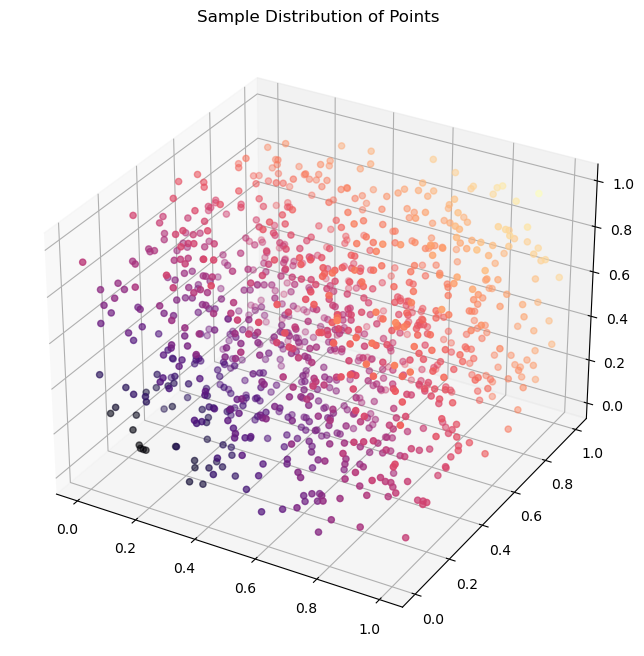

 -- Brute Force Method --
Numba compiled:      18.897135652433466
2.26 ms ± 46.8 µs per loop (mean ± std. dev. of 10 runs, 10 loops each)
Numba parallelized:   18.897135652433466
2.25 ms ± 30.7 µs per loop (mean ± std. dev. of 10 runs, 10 loops each)

 -- KD Tree Ballpoint Method --
Single process, leafsize 10:  18.897135652433466
152 ms ± 771 µs per loop (mean ± std. dev. of 4 runs, 2 loops each)
Parallelized, leafsize 10:    18.897135652433466
146 ms ± 902 µs per loop (mean ± std. dev. of 4 runs, 2 loops each)
Parallelized, leafsize 5:    18.897135652433466
147 ms ± 1.87 ms per loop (mean ± std. dev. of 4 runs, 2 loops each)
Parallelized, leafsize 20:    18.897135652433466
146 ms ± 1.59 ms per loop (mean ± std. dev. of 4 runs, 2 loops each)

 -- KD Tree Query Method --
Single process, leafsize 10, k = 100:  18.716373972114674
7.28 ms ± 204 µs per loop (mean ± std. dev. of 10 runs, 10 loops each)
Parallelized, leafsize 10, k = 100:    18.716373972114674
4.26 ms ± 273 µs per loop (mean

In [29]:
# Testing Suite

# testing parameters
_N = 1000    # number of points considered
_h = 0.15    # psuedo-smoothing length
_i = 0       # sample point to focus on for print

_k1, _k2, _k3 = 100, 50, 200   # maximum number of nearest neighbours checked for query method
_leafsize1, _leafsize2, _leafsize3 = 10, 5, 20  # number of points before which it begins a bruteforce method

# intial print
print("  ---- Testing Suite for Tree Method Implementations ----  ")
print("  Using N = {} and h = {}".format(_N, _h))
print()

# show initial distribution
_data = np.random.rand(_N, 3)
fig = plt.figure(figsize=(8, 8))
ax = plt.axes(projection='3d')
ax.scatter3D(_data[:, 0], _data[:, 1], _data[:, 2], c=[np.linalg.norm(v) for v in _data], cmap='magma');
plt.title("Sample Distribution of Points")
plt.show()

# begin testing
print(" -- Brute Force Method --")
print("Numba compiled:     ", bruteforce_compiled(_data, _h)[_i])
%timeit -n10 -r10  bruteforce_compiled(_data, _h)
print("Numba parallelized:  ", bruteforce_parallel(_data, _h)[_i])
%timeit -n10 -r10  bruteforce_compiled(_data, _h)
print()

print(" -- KD Tree Ballpoint Method --")
print("Single process, leafsize {}: ".format(_leafsize1), 
      kdtreemethod_ballpoint(_data, _h, workers=1, leafsize=_leafsize1)[_i])
%timeit -n2 -r4  kdtreemethod_ballpoint(_data, _h, workers=1, leafsize=_leafsize1)
print("Parallelized, leafsize {}:   ".format(_leafsize1), 
      kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize1)[_i])
%timeit -n2 -r4  kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize1)
print("Parallelized, leafsize {}:   ".format(_leafsize2), 
      kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize2)[_i])
%timeit -n2 -r4  kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize2)
print("Parallelized, leafsize {}:   ".format(_leafsize3), 
      kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize3)[_i])
%timeit -n2 -r4  kdtreemethod_ballpoint(_data, _h, workers=-1, leafsize=_leafsize3)
print()

print(" -- KD Tree Query Method --")
print("Single process, leafsize {}, k = {}: ".format(_leafsize1, _k1), 
      kdtreemethod_query(_data, k=_k1, h=_h, workers=1, leafsize=_leafsize1)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k1, h=_h, workers=1, leafsize=_leafsize1)
print("Parallelized, leafsize {}, k = {}:   ".format(_leafsize1, _k1), 
      kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize1)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize1)
print("Parallelized, leafsize {}, k = {}:   ".format(_leafsize2, _k1), 
      kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize2)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize2)
print("Parallelized, leafsize {}, k = {}:   ".format(_leafsize3, _k1), 
      kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize3)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k1, h=_h, workers=-1, leafsize=_leafsize3)
print("Parallelized, leafsize {}, k = {}:   ".format(_leafsize1, _k2), 
      kdtreemethod_query(_data, k=_k2, h=_h, workers=-1, leafsize=_leafsize1)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k2, h=_h, workers=-1, leafsize=_leafsize1)
print("Parallelized, leafsize {}, k = {}:   ".format(_leafsize1, _k3), 
      kdtreemethod_query(_data, k=_k3, h=_h, workers=-1, leafsize=_leafsize1)[_i])
%timeit -n10 -r10  kdtreemethod_query(_data, k=_k3, h=_h, workers=-1, leafsize=_leafsize1)
print()

print(" -- KD Tree Sparse Tree Method --")
print("Single process: ", sparse_tree_method(_data, h=_h)[_i])
%timeit -n5 -r4 sparse_tree_method(_data, h=_h)
print()

del _data

We can see that even with a fairly small smoothing length of $h=0.15$ and a large number of particles $N = 1000$, the simple ballpoint method is 2 orders of magnitude slower than the Numba compiled. I would guess that this has to do with having to with the standard python loop that I use to iterate through the neighbour array. Perhaps this could be improved by using list comprehension (though that is not always possible) or with a separate call to a function which iterates through the result of the ballpoint query. We can also see that the the sparse tree method is almost equally as inefficient. This is likely due to the fact that it is generating a NxN matrix of distances, which takes a lot of memory and computational time. We can be certain here that the bottleneck for the ballpoint and sparse tree methods is not the creation of the array since in the query method, we obtain numbers that are much closer to the brute force method. For particle numbers larger than 1000, this method may be a more efficient choice, at least in theory. However, in terms of implementation, it may be more difficult due to a few factors. Firstly, the query method implementation I made does not loop through elements in the returned distance array. Instead, it computes our psuedo-density using the vectorized numpy function. This is not necessarily possible for a general implementation, such as one including gravity calculations, or with differently massed particles. Also, we need to provide a value $k$ which represents the maximum number of neighbours to search for, which is not easily determined and can change throughout the simulation. Yet, we can see that this parameter has a drastic effect on the computation time. Further, for all KD-tree implementations, the leafsize parameter has some impact also, for which there is not an easy prescription either. In the end, we can see that for the scale which we are dealing with, the bruteforce method is simpler and not any slower compared to the Scipy tree methods after accounting for Numba pre-compiling. Using a custom tree method from a compiled language could possibly change this.

## Initial Conditions and Parameters

### Initial state ($y_0$)

In [30]:
M=1.0*Mearth #total mass
R=4.0*Rearth #Initial radius for particle distribution

N=1000 #number of particles

In [31]:
def generate_random_box_y0(N, R, randvel=False):
    """Uniformly random box ics"""
    y0=np.zeros((2, N*3))    # Initial state
    for i in range(N):
        y0[0, i*3:i*3+3]=(np.random.rand(3)-0.5)*R #start with random position
        if randvel: y0[1, i*3:i*3+3]=np.random.rand(3)/N #start with random velocity
    return y0

def generate_random_sphere_y0(N, R, randvel=False):
    """Uniformly random sphere ics"""
    y0=np.zeros((2, N*3))    # Initial state, starts with a sphere of points at 0 velocity
    for i in range(N):
        v=np.zeros(3)
        while True:
            v = (np.random.rand(3)-0.5)
            if v[0]**2 + v[1]**2 + v[2]**2 < 0.25: # if it is not in a sphere, try again until it is
                break
        y0[0, i*3:i*3+3]=v*R #start with random position
        if randvel: y0[1, i*3:i*3+3]=np.random.rand(3)/N #start with random velocity
    return y0

def generate_element_sphere(N, R, randvel=False, minrads=[0, 0.5], maxrads=[0.3, 1]):
    """Uniformly random sphere ics with element separation (indicated by particle index)."""
    y0=np.zeros((2, N*3))    # Initial state, starts with a sphere of points at 0 velocity
    for i in range(N):
        if i < int(parttype1_abund*N):  # particle 1
            minrad, maxrad = minrads[0], maxrads[0]
        else: # particle 2
            minrad, maxrad = minrads[1], maxrads[1]
        
        v=np.zeros(3)
        while True:
            v = (np.random.rand(3)-0.5)*2
            if minrad**2 < v[0]**2 + v[1]**2 + v[2]**2 < maxrad**2: # if it is not in a sphere, try again until it is
                break
        y0[0, i*3:i*3+3]=v*R #start with random position
        if randvel: y0[1, i*3:i*3+3]=np.random.rand(3)/N #start with random velocity
    return y0

In [32]:
# masses of particles
mass = np.ones(N)*M/N

# choose initial state  (generate distribution)
y0 = generate_random_sphere_y0(N, R, randvel=False) #generate_element_sphere(N,R,minrads=[0,0.5],maxrads=[0.3, 1])

In [33]:
# function to display particles in 3d
def display3D_state(y, title="Initial Positions", xlims=None, ylims=None, zlims=None, colorlist=None, cmap=None):
    """Makes a 3d image of the positions of the particles"""
    _N = len(y[0])//3

    if colorlist is None:
        colorlist = [np.linalg.norm(v) for v in y[0].reshape((_N, 3))]
        if cmap is None: cmap='magma'
    else:
        cmap = None
    
    fig = plt.figure(figsize=(8, 8))
    ax = plt.axes(projection='3d')
    ax.scatter3D(y[0].reshape((_N, 3)).T[0], 
                 y[0].reshape((_N, 3)).T[1], 
                 y[0].reshape((_N, 3)).T[2], 
                 c=colorlist, cmap=cmap);
    ax.set_xlabel('x [{}]'.format(LUNAME_LATEX)) 
    ax.set_ylabel('y [{}]'.format(LUNAME_LATEX))
    ax.set_zlabel('z [{}]'.format(LUNAME_LATEX))
    ax.set_xlim3d(xlims)
    ax.set_ylim3d(ylims)
    ax.set_zlim3d(zlims)
    plt.title(title)
    plt.show()

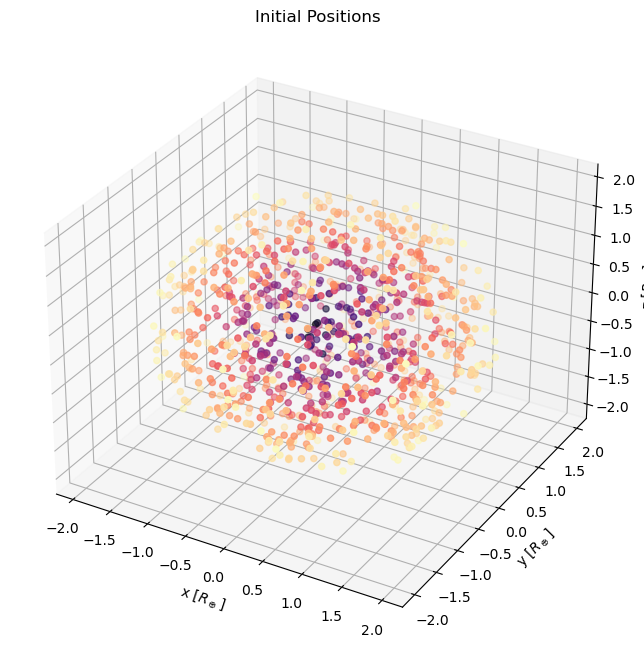

In [34]:
# check out the scatter of the initial positions (dark color indicates close to the center of the box)
fig = plt.figure(figsize=(8, 8))
ax = plt.axes(projection='3d')
ax.scatter3D(y0[0].reshape((N, 3)).T[0], y0[0].reshape((N, 3)).T[1], y0[0].reshape((N, 3)).T[2], c=[np.linalg.norm(v) for v in y0[0].reshape((N, 3))], cmap='magma');
ax.set_xlabel('x [{}]'.format(LUNAME_LATEX)); ax.set_ylabel('y [{}]'.format(LUNAME_LATEX)); ax.set_zlabel('z [{}]'.format(LUNAME_LATEX))
plt.title("Initial Positions")
plt.show()

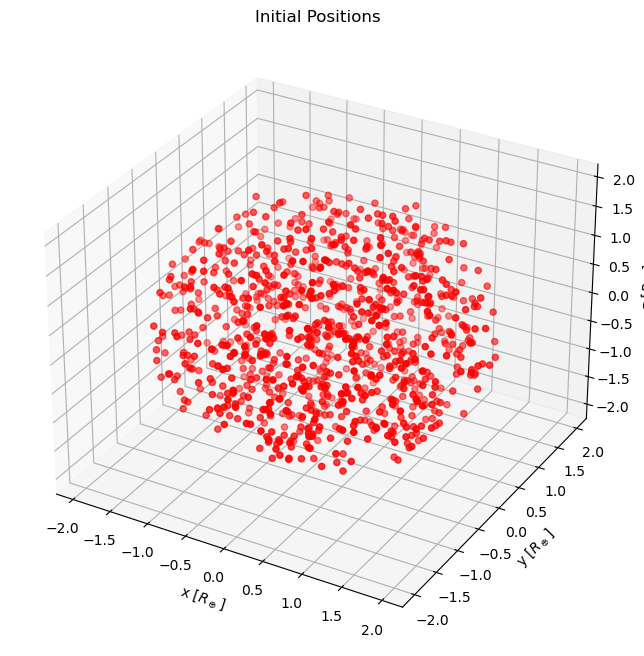

In [35]:
# check out the scatter of the initial positions (red indicates particle 1, blue indicates particle 2)
display3D_state(y0, title="Initial Positions",
                colorlist=[(1, 0, 0) if i < int(N*parttype1_abund) else (0,0,1) for i in range(N)], cmap=None)

### Smoothing Length ($h$)

To get an appropriate approximate initial smoothing length, we would like to have around $k \approx 10$ particles in it. We will take a small box within the collection of particles with length $h$ such that the number of particles inside is $k$. The volume of the small box is $V_1 = h^3$ and so the number density is $n_1 \equiv \frac{k}{V_1} = \frac{k}{h^3}$. Since the particles are initially uniformally distributed and our simulation does not vary $h$ (it does not have significantly large variations in densities or pressures), we can assume that the number density of all of the initial particles is equal to that of the small box. Namely, if $n$ is the number density of all of the particles, $n = n_1$. Then, 

$$\frac{k}{h^3} = n_1 = n = \frac{N}{V} = \frac{N}{R^3}$$
$$\implies h \approx R\left(\frac{k}{N}\right)^\frac{1}{3}$$

Since we expect the radius to contract by about 4 times, we must divide this result by 4 to get the smoothing length appropriate for a more dense planet.

In [36]:
print("h should be about", R*(10/N)**(1/3)/4., "Length units")

h should be about 0.2154434690031884 Length units


In [37]:
# our choice of the smoothing length (in earth radii)
h = 0.11  

### Time increment ($\delta t$)

We want to pick an appropriate $\delta t$ such that the Courant-Friedrichs-Levy (CFL) condition is satisfied. Namely, we want

$$\delta t < \frac{h}{c_s}$$

where $c_s$ is the speed of sound given by 

$$ c_s \equiv \sqrt{\frac{dP}{d\rho}} \equiv \sqrt{\frac{K}{\rho}}$$

where $K_0$ is the bulk modulus of the material. In order to satisfy this condition for the entire simulation, we must choose the maximum value of $c_s$. 

In [38]:
expected_idensity = 3*M/(4*np.pi*R*R*R)
print("The expected initial average density is: {} {}".format(expected_idensity*MOD_DENSU, MOD_DENSNAME))

print("Thus, the CFL condition requires dt <", 
      h/np.sqrt(max(K0_parttype1, K0_parttype2)/min(rho0_parttype1, rho0_parttype2, expected_idensity)), TUNAME)

The expected initial average density is: 0.08586407347117393 g/cm^3
Thus, the CFL condition requires dt < 0.15866336550124785 Time units


In [39]:
dt = 0.1 #dt = 0.0002 # our choice of the dt (hour)

### Test the initial conditions

In [40]:
def calc_average_spherical_density(xs, ys, zs, dens):
    return np.average((xs*xs + ys*ys + zs*zs)*dens)/np.average((xs*xs + ys*ys + zs*zs))

Expected initial density:  0.08586407347117393 g/cm^3
Measured initial density:  0.5616512483514005 g/cm^3
Ratio: 6.541167052131024 



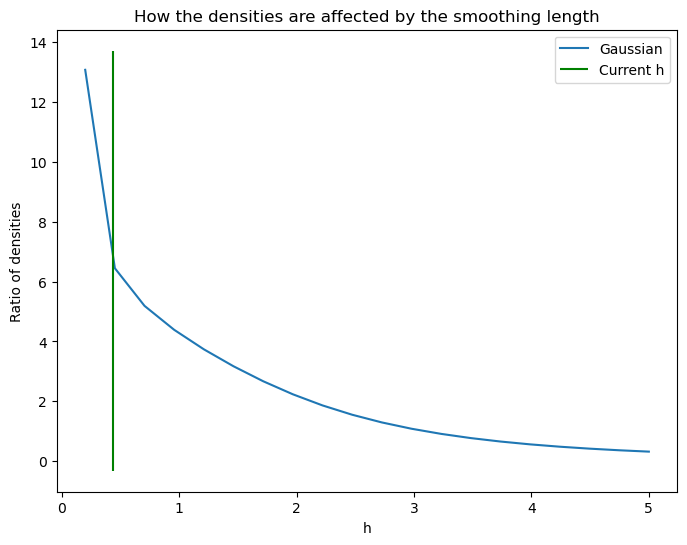

In [41]:
# how the densities are affected by h (this is a testing script to find better values for h)

# manual test
_h = h*4.0
initial_density = calc_average_spherical_density(y0[0, 0::3], y0[0, 1::3], y0[0, 2::3], calcdensity(y0[0],mass,N,_h))
print("Expected initial density: ", expected_idensity*MOD_DENSU, MOD_DENSNAME)
print("Measured initial density: ", initial_density*MOD_DENSU, MOD_DENSNAME)
print("Ratio:", initial_density/expected_idensity, "\n")

# range of values
_hs = np.linspace(0.2, 5, 20)
_ratiodens = {
    kernel_name: [calc_average_spherical_density(y0[0, 0::3], y0[0, 1::3], y0[0, 2::3], calcdensity(y0[0],mass,N,_h))/expected_idensity for _h in _hs],
}

fig = plt.figure(figsize=(8, 6))
_legend = []
for _n, _rden in _ratiodens.items():
    plt.plot(_hs, _rden)
    _legend.append(_n)

plt.vlines([_h], *plt.ylim(), color="green")
_legend.append("Current h")

plt.xlabel('h'); plt.ylabel('Ratio of densities'); plt.title("How the densities are affected by the smoothing length")
plt.yscale('linear');plt.legend(_legend)

## Run the model

In [44]:
tstart=0.0 #starting time
tend=800  # ending time
nu=0.1 # viscosity (higher => more viscous, 0 => no viscosity)

t_span=[tstart, tend]

# run the simulation!
trange, ans = leapfrog(y0, dt, t_span, mass, N, h, nu=nu)  # or run_runge_kutta

  0%|          | 0/8001 [00:00<?, ?it/s]

### Profiling code to find bottlenecks

In [35]:
# profile to find the bottlenecks
import cProfile
import pstats
from pstats import SortKey
profile = cProfile.Profile()
profile.runcall(lambda: leapfrog(y0, dt, [0, 10*dt], mass, N, h, nu=nu))
ps = pstats.Stats(profile)
ps.strip_dirs().sort_stats(SortKey.CUMULATIVE).print_stats()

  0%|          | 0/11 [00:00<?, ?it/s]

         59961 function calls (50692 primitive calls) in 0.466 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.000    0.000    0.466    0.466 4198858614.py:6(<lambda>)
        1    0.001    0.001    0.466    0.466 1143064638.py:3(leapfrog)
       10    0.421    0.042    0.421    0.042 734316798.py:50(calcdxdt)
        1    0.000    0.000    0.035    0.035 notebook.py:210(__init__)
        1    0.000    0.000    0.030    0.030 notebook.py:101(status_printer)
     11/4    0.000    0.000    0.029    0.007 widget.py:409(__init__)
     11/4    0.000    0.000    0.028    0.007 widget.py:425(open)
    26/19    0.000    0.000    0.028    0.001 widget.py:492(get_state)
4155/1605    0.001    0.000    0.026    0.000 traitlets.py:566(__get__)
 1415/884    0.002    0.000    0.025    0.000 traitlets.py:535(get)
10264/4690    0.003    0.000    0.023    0.000 {built-in method builtins.getattr}
  368/100    0.001    0.000  

## Display results

### Density Slice Plots and Animations

In [46]:
@jit(nopython=True)
def get_centered_pos_and_rho(ansi, mass, h, N):
    """Returns the centered position and the mass density for each particle at a given state for a particular time."""
    x=[ansi[nvec*j  ] for j in range(N)]
    y=[ansi[nvec*j+1] for j in range(N)]
    z=[ansi[nvec*j+2] for j in range(N)]

    CoMx=np.sum(x*mass)/np.sum(mass)   # get COM
    CoMy=np.sum(y*mass)/np.sum(mass)
    CoMz=np.sum(z*mass)/np.sum(mass)

    rho=calcdensity(ansi,mass,N,h)  # calc density
    
    return x-CoMx, y-CoMy, z-CoMz, rho

@jit(nopython=True)
def get_centered_pos_and_rho_2(ansi, mass,h, N):
    """Returns the centered position and the mass density for each particle at a given state for a particular time."""
    x=ansi[0, 0::3]
    y=ansi[0, 1::3]
    z=ansi[0, 2::3]

    CoMx=np.sum(x*mass)/np.sum(mass)   # get COM
    CoMy=np.sum(y*mass)/np.sum(mass)
    CoMz=np.sum(z*mass)/np.sum(mass)

    rho=calcdensity(ansi[0],mass,N,h)  # calc density
    
    return x-CoMx, y-CoMy, z-CoMz, rho

In [47]:
"""
To generate this image I take a finite slice of the 3d density distribution for the planet and average 
over the z elements inside the slice for each x and y in the resolution determined by the cell size. 
"""

def calculate_avg_density_cells(ansi, mass, N, h, cell_range = [-1, 1, -1, 1], slice_ = [-0.45, 0.45]):
    xp, yp, zp, dens = get_centered_pos_and_rho_2(ansi, mass, h, N)  # remove the _2 for solve_ivp integrator form (to do: generalize)
    cellres = int((cell_range[1] - cell_range[0])/(h*1.5))  #int(np.sqrt(N)*(slice_[1] - slice_[0])) # sqrt of number of even cells
    density_cells = np.zeros((cellres, cellres))
    distance_cells = np.zeros((cellres, cellres))

    for x, y, z, d in zip(xp, yp, zp, dens):
        if slice_[0] < z < slice_[1]:
            _i, _j = int(cellres*(x-cell_range[0])/(cell_range[1] - cell_range[0])), int(cellres*(y-cell_range[2])/(cell_range[3] - cell_range[2]))
            _i, _j = max(min(_i, cellres-1), 0), max(min(_j, cellres-1), 0)
            density_cells[_i, _j] += (x*x+y*y+z*z)*d  # spherical mean
            distance_cells[_i, _j] += (x*x+y*y+z*z)
    
    avg_density_cells = density_cells / distance_cells
    return avg_density_cells
    
def plot_density_cell_map(i, ans, mass, N, trange, h, cell_range=[-1, 1, -1, 1], slice_=[-0.45, 0.45], 
                          title="Density map of the planet"):
    avg_density_cells = calculate_avg_density_cells(ans[i], mass, N, h, cell_range=cell_range, slice_=slice_)

    fig = plt.figure(figsize=(8, 8))
    plt.title("{} at t = {:2.4f} {}".format(title, trange[i], TUNAME), fontsize=13)
    ax = plt.gca()
    im = plt.imshow(np.transpose(avg_density_cells*MOD_DENSU), cmap='Reds', extent=cell_range)
    ax.set_xlabel(r"$x$ [{}]".format(LUNAME_LATEX), fontsize=13)  # in LU
    ax.set_ylabel(r"$y$ [{}]".format(LUNAME_LATEX), fontsize=13)  # in LU
    cbar = plt.colorbar(im, ax=ax, location='right', anchor=(0, 0.5), shrink=0.8)
    cbar.set_label(MOD_DENSNAME_LATEX)
    
    return fig, im

def anim_density_cell_map(ans, mass, N, trange, h, cell_range=[-1, 1, -1, 1], slice_=[-0.45, 0.45], 
                          outfn='test_anim.mp4', fps=20, title="Density map of the planet"):
    """ Animates the density map accross all times in ans. Saves the result as an mp4 file."""
    nframes = len(ans)
    fig, im = plot_density_cell_map(-1, ans, mass, N, trange, h, cell_range=cell_range, slice_=slice_) # inital frame
    avg_density_cells = calculate_avg_density_cells(ans[0], mass, N, h, cell_range=cell_range, slice_=slice_)
    im.set_array(np.transpose(avg_density_cells*MOD_DENSU))
    
    def animate_func(i):
        if i % fps == 0: print('.', end ='')
        avg_density_cells = calculate_avg_density_cells(ans[i], mass, N, h, cell_range=cell_range, slice_=slice_)
        im.set_array(np.transpose(avg_density_cells*MOD_DENSU))
        plt.title("{} at t = {:2.4f} {}".format(title,trange[i], TUNAME))
        return [im]

    anim = animation.FuncAnimation(fig, animate_func, frames = nframes, interval = 1000 / fps)
    writergif = animation.FFMpegWriter(fps=fps) #PillowWriter(fps=fps) 
    anim.save(outfn, writer=writergif)
    #anim.save(outfn, fps=fps, extra_args=['-vcodec', 'libx264'])


C:\Users\Jaeden\AppData\Local\Temp\ipykernel_18860\1079229127.py:19: RuntimeWarning: invalid value encountered in divide
  avg_density_cells = density_cells / distance_cells


..

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_18860\1079229127.py:19: RuntimeWarning: invalid value encountered in divide
  avg_density_cells = density_cells / distance_cells


......Done!


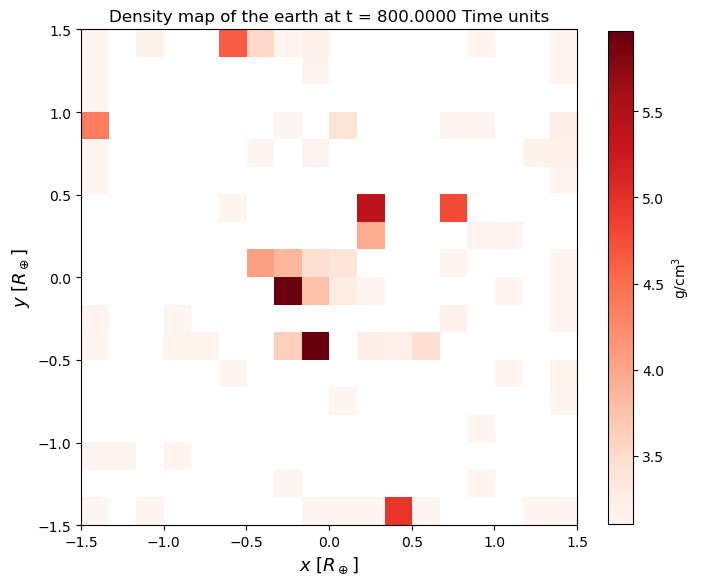

In [51]:
# this is from a 100% iron run # temp
anim_density_cell_map(ans[::20], mass, N, trange[::20], h, cell_range=[-1.5, 1.5, -1.5, 1.5], slice_=[-0.45, 0.45], fps=60, title="Density map of the earth")
print("Done!")

#### Get final average density

In [39]:
# Test density values
xs, ys, zs, dens = get_centered_pos_and_rho_2(ans[-1], mass, h, N)
dens_cgs = (dens*MU/(LU*LU*LU))/1000
print("Mean density of planet:", np.sum((xs*xs+ ys*ys+ zs*zs)*dens_cgs)/np.sum((xs*xs+ ys*ys+ zs*zs)), "g/cm^3")
print("Min:", min(dens_cgs), "g/cm^3", " Max:", max(dens_cgs), "g/cm^3")

Mean density of planet: 6.301363904572685 g/cm^3
Min: 6.21165322237635 g/cm^3  Max: 11.701971735602992 g/cm^3


#### Plots

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_15712\1079229127.py:19: RuntimeWarning:

invalid value encountered in true_divide



Density map of the earth at t = 800.0 Time units


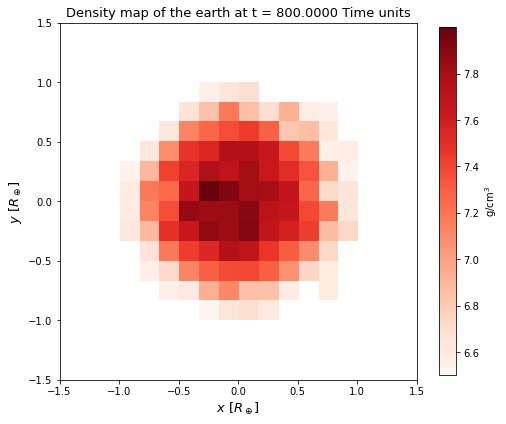

In [891]:
# this is from a 100% iron run
_i = -1
slice_ = [-0.5, 0.5]
cell_range = [-1.5, 1.5, -1.5, 1.5]
plot_density_cell_map(_i, ans, mass, N, trange, h, cell_range=cell_range, slice_=slice_, title="Density map of the earth")
print("Density map of the earth at t = {} {}".format(trange[_i], TUNAME))

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_17448\4148951071.py:19: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_17448\4148951071.py:19: RuntimeWarning:

invalid value encountered in true_divide



..........Done!


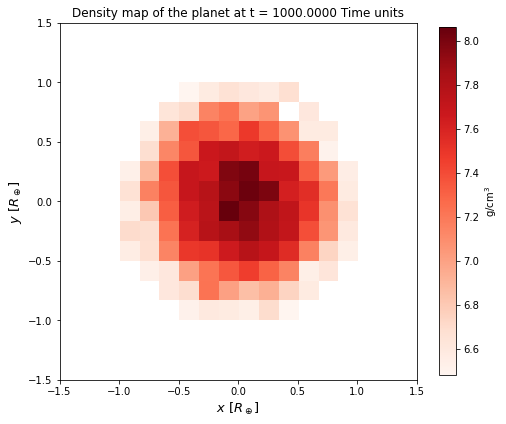

In [77]:
# this is from a 100% iron run
anim_density_cell_map(ans[::20], mass, N, trange[::20], h, cell_range=[-1.5, 1.5, -1.5, 1.5], slice_=[-0.45, 0.45], fps=60, title="Density map of the earth")
print("Done!")

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_17084\1079229127.py:19: RuntimeWarning: invalid value encountered in true_divide
  avg_density_cells = density_cells / distance_cells


Density map of the earth at t = 800.0 Time units


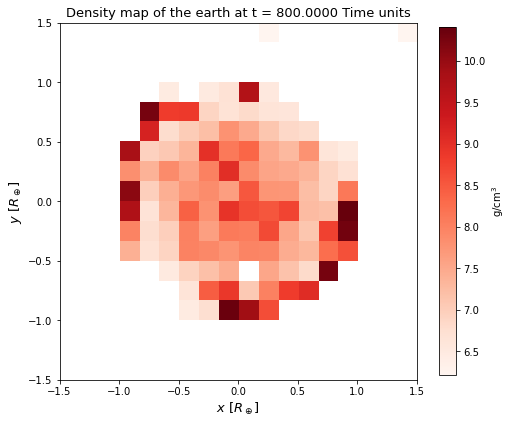

In [41]:
# this is from a 30% iron, 70% silicate run with random distribution
_i = -1
slice_ = [-0.5, 0.5]
cell_range = [-1.5, 1.5, -1.5, 1.5]
plot_density_cell_map(_i, ans, mass, N, trange, h, cell_range=cell_range, slice_=slice_, title="Density map of the earth")
print("Density map of the earth at t = {} {}".format(trange[_i], TUNAME))

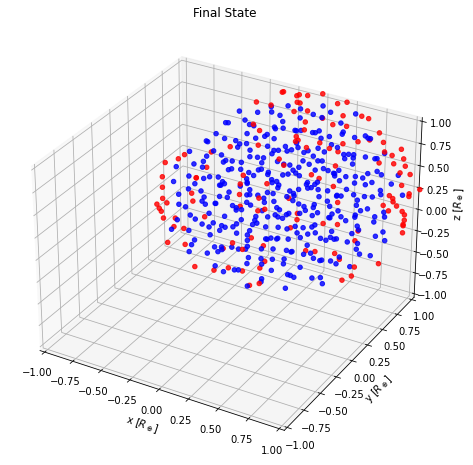

In [48]:
# this is from a 30% iron (red), 70% silicate (blue) run with random distribution
_i = -1
display3D_state(ans[_i], title="Final State", xlims=[-1, 1], ylims=[-1, 1], zlims=[-1, 1], 
                colorlist=[(1, 0, 0) if i < int(N*parttype1_abund) else (0,0,1) for i in range(N)], cmap=None)

### Dr. Rowe's Plotly plotting routines (modified)

In [43]:
def makecolourmap(ncolours):
    """
    Will generate RGB colours from a colour map that will work with Plotly
    ncolours : number of sequential colours to sample from colour map.
    """
    
    r=[] #Blank list to hold R,G,B values
    g=[]
    b=[]

    # for chex in px.colors.cyclical.HSV: 
    #     r.append(int(chex[1:3],16))
    #     g.append(int(chex[3:5],16))
    #     b.append(int(chex[5:7],16))
    
    for c in px.colors.cyclical.Phase: #Cycle through the colour map and extract RGB
        lenc=len(c)
        r1,g1,b1=re.split(',',c[4:lenc-1])
        r.append(int(r1))
        g.append(int(g1))
        b.append(int(b1))
    
    r=np.array(r) #Convert list to Numpy Array
    g=np.array(g)
    b=np.array(b)
    idx=np.linspace(0,1,len(r)) #corresponding Index
    
    r_cs = CubicSpline(idx, r) #use Cubic Spline for sampling
    g_cs = CubicSpline(idx, g)
    b_cs = CubicSpline(idx, b)

    cmap=[]
    for i in range(ncolours): #Generate Samples
        idx1=i/(ncolours-1)
        r1=np.min([np.max([int(r_cs(idx1)),int(0)]),int(255)])
        g1=np.min([np.max([int(g_cs(idx1)),int(0)]),int(255)])
        b1=np.min([np.max([int(b_cs(idx1)),int(0)]),int(255)])
        c1 = 'rgb('+str(r1)+','+str(g1)+','+str(b1)+')'
        cmap.append(c1)

    return cmap

def anim_nbody_pos_2(ans,mass,trange,au,nbody, sample_param=100):
    
    cmap=makecolourmap(nbody)

    nt=len(trange)
    nsample=int(nt/sample_param)+1
    
    xp=[]
    yp=[]
    rhop=[]

    for i in range(0,nt,nsample):
        x=ans[i][0, 0::3]
        y=ans[i][0, 1::3]
        CoMx=np.sum(x*mass)/np.sum(mass)
        CoMy=np.sum(y*mass)/np.sum(mass)
        
        xp.append(x-CoMx)
        yp.append(y-CoMy)
        
        rho=calcdensity(ans[i, 0],mass,N,h)
        
        rhop.append(rho)
        
    amax=1.1
    
    nplot=len(xp)
    print(nplot)
    
    fig = go.Figure(
        data=[go.Scatter(x=[0.0], y=[0.0],
                         mode='markers', marker=dict(color="blue")),
              go.Scatter(x=[0.0], y=[0.0],
                         mode='markers', marker=dict(color="blue"))],
        layout=go.Layout(width=800, height=800,
                         showlegend=False,
            xaxis=dict(range=[-amax, amax], autorange=False, zeroline=False),
            yaxis=dict(range=[-amax, amax], autorange=False, zeroline=False),
            title_text="SPH Demo", hovermode="closest",
            updatemenus=[dict(type="buttons",
                              buttons=[dict(label="Play",
                                            method="animate",
                                            args=[None])])]),
        frames=[go.Frame(
            data=[go.Scatter(
                x=xp[k],
                y=yp[k],
                mode="markers",
                marker=dict(color=rhop[k], size=10))])

            for k in range(nplot)]
    )

    fig.write_html("sph.html")
    fig.show()

In [609]:
anim_nbody_pos_2(ans,mass,trange,0,N, sample_param=30)

30


## Planetary Collision

In [292]:
# make a copy of the earth from the above sim
settled_earth = ans[-1].copy()

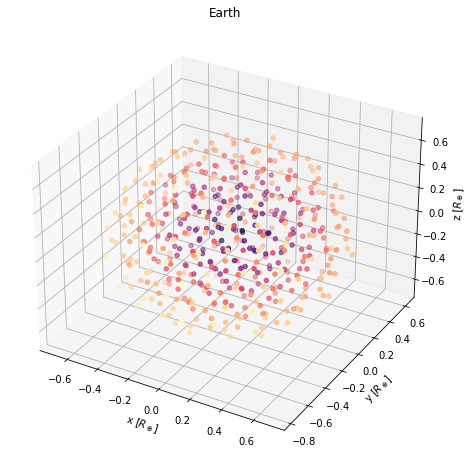

In [621]:
display3D_state(settled_earth, "Earth")

### Creating a Moon

In [105]:
# generate a moon with 
N_moon = int(N*(Rmoon/Rearth))
print("Using {} particles.".format(N_moon))
M_moon = Mmoon
R_moon = 4*Rmoon
h_moon = h*(Rmoon/Rearth)
mass_moon = np.ones(N_moon)*M_moon/N_moon
y0_moon = generate_random_box_y0(N_moon, R_moon, randvel=False)
trange_moon, ans_moon = leapfrog(y0_moon, dt, t_span, mass_moon, N_moon, h_moon, nu=nu)

Using 272 particles.


  0%|          | 0/8001 [00:00<?, ?it/s]

In [624]:
# Test density values
xs, ys, zs, dens = get_centered_pos_and_rho_2(ans_moon[-1], mass_moon, N_moon, h_moon)
dens_cgs = (dens*MU/(LU*LU*LU))/1000
print("Mean density of planet:", np.sum((xs*xs+ ys*ys+ zs*zs)*dens_cgs)/np.sum((xs*xs+ ys*ys+ zs*zs)), "g/cm^3")
print("Min:", min(dens_cgs), "g/cm^3", " Max:", max(dens_cgs), "g/cm^3")

Mean density of planet: 3.348713098892405 g/cm^3
Min: 2.3169202075764925 g/cm^3  Max: 6.358174427650528 g/cm^3


C:\Users\Jaeden\AppData\Local\Temp\ipykernel_17084\1079229127.py:19: RuntimeWarning:

invalid value encountered in true_divide



Density map of the moon at t = 800.0 Time units


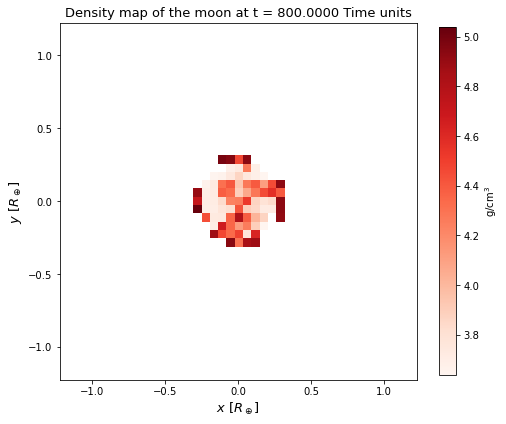

In [106]:
_i = -1
slice_ = [-0.5, 0.5]
cell_range = np.array([-1, 1, -1, 1])*(Rmoon/Rearth)*4.5
plot_density_cell_map(_i, ans_moon, mass_moon, N_moon, trange_moon, h_moon*1.25, cell_range=cell_range, slice_=slice_, title="Density map of the moon")
print("Density map of the moon at t = {} {}".format(trange[_i], TUNAME))

In [282]:
# make a copy of the moon
settled_moon = ans[-1].copy()

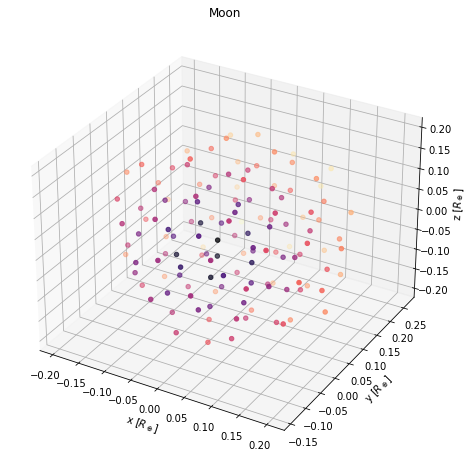

In [317]:
display3D_state(settled_moon, "Moon")

### Send them at each other

Since the moon is much smaller than the Earth, it requires a smaller smoothing length to resolve the interactions. Moreover, we need to have the same smoothing length for both the planets in order for them not to explode from instability. This means that we would require an Earth simulation with a lot more particles in order to resolve the Moon properly. This would be very computationally expensive, so instead we will consider an Earth-Earth system to start.

In [683]:
# setting up the two bodies (body1 is the target and body2 is the impactor)
body1, body2 = settled_earth, settled_earth  # or settled_moon
N1, N2 = N, N  # or N_moon
M1, M2 = M, M  # or M_moon
R1, R2 = Rearth, Rearth # or Rmoon
mass1, mass2 = mass, mass  # or mass_moon

N_collide = N1 + N2 #number of particles
M_collide = M1 + M2
h_collide = h  #smoothing length (must be the same smoothing length between the simulations)
mass_collide = np.concatenate([mass1, mass2])

#### Escape velocity

We will use the escape velocity to determine the speed at which we should initially launch the impactor. The mutual escape velocity between two bodies is

$$v_{esc} = \sqrt{\frac{2G(M_{1}+M_{2})}{R_{1}+R_{2}}}% (Canup et al., 2004)$$

In [684]:
def escape_velocity(M1, M2, R1, R2):
    return math.sqrt(2*Gr*(M1+M2)/(R1+R2))

In [685]:
v_esc = escape_velocity(M1, M2, R1, R2)
print("The escape velocity is {} {}".format(v_esc*LU/TU/1000, "km/s"))

The escape velocity is 11.179831355959498 km/s


#### Initial state

In [862]:
# Initial state function
def initial_collision_state(N1, N2, ans1, ans2, idist, ivel, impactparam):
    y0 = np.zeros((2, 3*(N1+N2)))
    for i in range(N1):  # object 1
        y0[0, i*3:i*3+3] = ans1[0, i*3:i*3+3]
        y0[1, i*3:i*3+3] = ans1[1, i*3:i*3+3]

    for i in range(N2):  # object 2
        k = N1 + i
        y0[0, k*3:k*3+3] = ans2[0, i*3:i*3+3] + np.array([idist, impactparam, 0])
        y0[1, k*3:k*3+3] = ans2[1, i*3:i*3+3] + np.array([-ivel, 0, 0])
        
    return y0

In [874]:
# initial conditions
idist = 3*Rearth  # initial distance (between centers)
ivel = 3*escape_velocity(M1, M2, R1, R2)  # initial velocity of projectile
impactparam = 0.5*R1 # impact parameter (distance in y, center to center)

y0_collide = initial_collision_state(N1, N2, body1, body2, idist, ivel, impactparam)

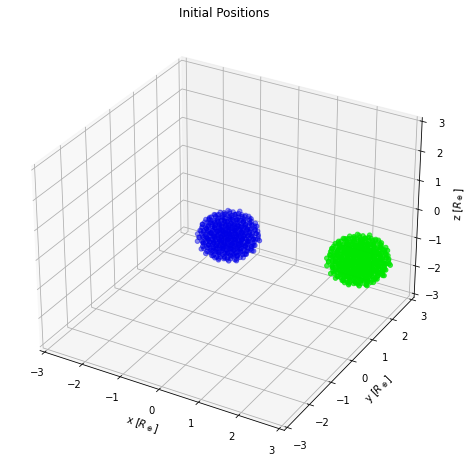

In [875]:
# check out the scatter of the initial positions (dark color indicates close to the center of the box)
display3D_state(y0_collide, xlims=[-idist, idist], ylims=[-idist, idist], zlims=[-idist, idist], 
                colorlist=[(0, 0, 0.9, 0.9) if i < N else (0, 0.9, 0, 0.9) for i in range(N_collide)])

In [876]:
# run the simulation
t_span_collide = [0.0, 200.0]
trange_collide, ans_collide = leapfrog(y0_collide, dt, t_span_collide, mass_collide, N_collide, h_collide, nu=0.01)

  0%|          | 0/2001 [00:00<?, ?it/s]

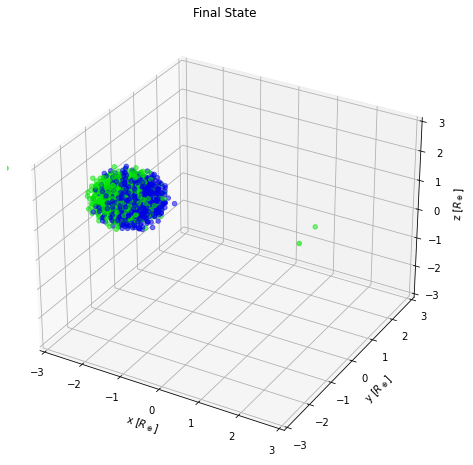

In [877]:
display3D_state(ans_collide[700], xlims=[-idist, idist], ylims=[-idist, idist], zlims=[-idist, idist],
               colorlist=[(0, 0, 0.9, 0.9) if i < N else (0, 0.9, 0, 0.9) for i in range(N_collide)], title="Final State")

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_15712\1079229127.py:19: RuntimeWarning:

invalid value encountered in true_divide



Earth-Earth Collision at t = 10.0 Time units


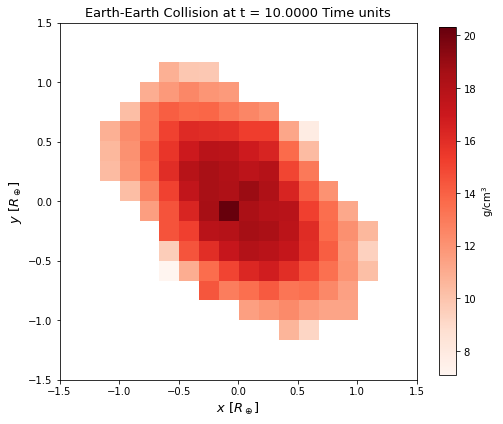

In [867]:
_i = 100
slice_ = [-0.5, 0.5]
cell_range = [-1.5, 1.5, -1.5, 1.5]
plot_density_cell_map(_i, ans_collide, mass_collide, N_collide, trange_collide, h_collide, cell_range=cell_range, slice_=slice_, title="Earth-Earth Collision")
print("Earth-Earth Collision at t = {} {}".format(trange_collide[_i], TUNAME))

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_15712\1079229127.py:19: RuntimeWarning:

invalid value encountered in true_divide



..

C:\Users\Jaeden\AppData\Local\Temp\ipykernel_15712\1079229127.py:19: RuntimeWarning:

invalid value encountered in true_divide



.................................Done!


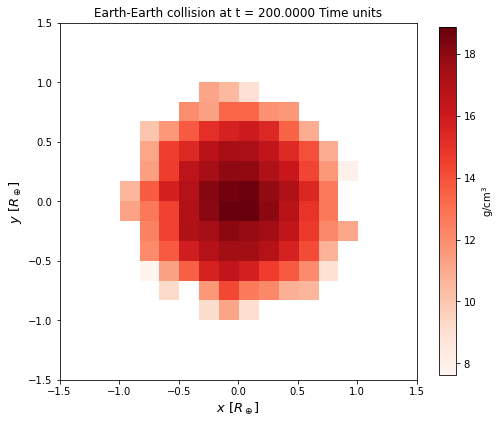

In [858]:
anim_density_cell_map(ans_collide[::], mass_collide, int(N_collide), trange_collide[::], h_collide, cell_range=[-1.5, 1.5, -1.5, 1.5], slice_=[-0.45, 0.45], fps=60, title="Earth-Earth collision")
print("Done!")

In [878]:
anim_nbody_pos_2(ans_collide,mass_collide,trange_collide,0, N_collide, sample_param=200)

182
